# Importing libraries

In [ ]:
import os
import cv2
import math
# import pafy
import random
import numpy as np
import datetime as dt
import tensorflow as tf
from moviepy.editor import *
from collections import deque
import matplotlib.pyplot as plt
%matplotlib inline
 
from sklearn.model_selection import train_test_split
 
from tensorflow.keras.layers import *
from tensorflow.keras.models import Sequential
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.utils import plot_model

# Installing Shopping dataset for activity recognition 

In [ ]:
# !wget https://www.merl.com/pub/tmarks/MERL_Shopping_Dataset/Videos_MERL_Shopping_Dataset.zip

In [ ]:
b=!unzip data_act.zip

## 2.0 Unzipping data

In [ ]:
# b=!unzip /content/Videos_MERL_Shopping_Dataset.zip
a = !unzip olyapti.zip
b = !unzip quyayapdi.zip
c = !unzip ushlab_turibdi.zip
d = !unzip yuryapti.zip

In [ ]:
# !wget https://www.merl.com/pub/tmarks/MERL_Shopping_Dataset/Labels_MERL_Shopping_Dataset.zip

In [ ]:
# a=!unzip /content/Labels_MERL_Shopping_Dataset.zip

In [ ]:
# !wget https://www.merl.com/pub/tmarks/MERL_Shopping_Dataset/Results_MERL_Shopping_Dataset.zip

In [ ]:
# c = !unzip Results_MERL_Shopping_Dataset.zip

In [ ]:
# !wget https://raw.githubusercontent.com/NVIDIA-AI-IOT/TAO-Toolkit-Whitepaper-use-cases/ba7320e64fc4e16876370b2156dcdce801df34d5/workspace/ar_merl/convert.py

## 2.1 Preparing dataset

In [ ]:
seed_constant = 23
np.random.seed(seed_constant)
random.seed(seed_constant)
tf.random.set_seed(seed_constant)

In [ ]:
image_height, image_width = 64, 64
# max_images_per_class = 1000
 
dataset_directory = "/content/Shopping_action"
classes_list = ["Taking product", "Holding product", "Walking", "Putting product"]
 
model_output_size = len(classes_list)

In [ ]:
# ! python convert.py --data_split data --labels_path=/content/Labels_MERL_Shopping_Dataset --video_path=/content/Videos_MERL_Shopping_Dataset

In [ ]:
data_path = "Shopping_action"

os.makedirs(data_path, exist_ok = True)

In [ ]:
# !ls data/Hand_in_Shelf
for dirpath, dirname, filename in os.walk(data_path):
        print(f"There are {len(dirname)} directories and {len(filename)} images in {dirpath}")
        print(dirpath.split('/')[-1])

There are 5 directories and 0 images in Shopping_action
Shopping_action
There are 0 directories and 11 images in Shopping_action/holding
holding
There are 0 directories and 20 images in Shopping_action/walking
walking
There are 1 directories and 14 images in Shopping_action/putting
putting
There are 0 directories and 0 images in Shopping_action/putting/.ipynb_checkpoints
.ipynb_checkpoints
There are 0 directories and 37 images in Shopping_action/taking
taking
There are 0 directories and 0 images in Shopping_action/.ipynb_checkpoints
.ipynb_checkpoints


In [ ]:

import os 

def walk_through_thedata():
    features = []
    labels = []
    for dirpath, dirname,  filename in os.walk(f"{data_path}"):
        for vid in filename:
            vid_path = f"{dirpath}/{vid}"
            class_name = dirpath.split('/')[-1]
            print(vid_path)
            cap = cv2.VideoCapture(vid_path)
            while True:
                ret, frame = cap.read()
                if not ret:
                    break
                if class_name=='taking':
                    labels.append(0)
                if class_name=='putting':
                    labels.append(1)
                if class_name=='walking':
                    labels.append(2)
                if class_name=='holding':
                    labels.append(3)
                resized_frame = cv2.resize(frame, (image_height, image_width))
                normalized_frame = resized_frame/255.
                features.append(normalized_frame)

    features = np.asarray(features)
    labels = np.asarray(labels)
    return features, labels

features, labels = walk_through_thedata()

Shopping_action/holding/0609 (1)(5)1.mp4
Shopping_action/holding/0609 (1)(5).mp4
Shopping_action/holding/0609(11).mp4
Shopping_action/holding/0609 (1)(6).mp4
Shopping_action/holding/0609 (1)(9).mp4
Shopping_action/holding/0609 (1).mp4
Shopping_action/holding/0609(7).mp4
Shopping_action/holding/06092.mp4
Shopping_action/holding/0609.mp4
Shopping_action/holding/0609(5).mp4
Shopping_action/holding/0609(2).mp4
Shopping_action/walking/0609 (1)(5).mp4
Shopping_action/walking/0609(1).mp4
Shopping_action/walking/0609(11).mp4
Shopping_action/walking/0609(3).mp4
Shopping_action/walking/0609 (1)(4).mp4
Shopping_action/walking/0609 (1)(6).mp4
Shopping_action/walking/0609 (1)(8)3.mp4
Shopping_action/walking/0609 (1)(3).mp4
Shopping_action/walking/0609 (1).mp4
Shopping_action/walking/0609 (1)(8.mp4
Shopping_action/walking/0609 (1)(8)6.mp4
Shopping_action/walking/0609 (1)(1).mp4
Shopping_action/walking/0609 (1)(8).mp4
Shopping_action/walking/0609 (1)(2).mp4
Shopping_action/walking/0609.mp4
Shopping_a

In [ ]:
# False in labels==np.ones(labels.shape)
features.shape, labels.shape

((10832, 64, 64, 3), (10832,))

### 2.2 

In [ ]:
# def create_dataset():
 
#     # Declaring Empty Lists to store the features and labels values.
#     temp_features = [] 
#     frames = []
#     features = []
#     labels = []
#     ever = []
#     # Iterating through all the classes mentioned in the classes list       
#     for class_index, class_name in enumerate(classes_list):
#         print(f'Extracting Data of Class: {class_name}')
#         for dirpath, dirname, filename in os.walk(f"{dataset_directory}/{class_name}"):
#             frames = []
#             if dirpath.endswith('rgb'):
#                 for i in filename:
#                     frame = cv2.imread(f"{dirpath}/{i}")
#                     resized_frame = cv2.resize(frame, (image_height, image_width))
#                     normalized_frame = resized_frame/255.
#                     features.append(normalized_frame)
#                 # ever.append(np.array(frames))
#                     labels.append(class_index)
 
#     # Converting the features and labels lists to numpy arrays
#     features = np.asarray(features)
#     labels = np.array(labels)  
 
#     return features, labels


In [ ]:
# features, lebels = create_dataset()

In [ ]:
features.shape

(10832, 64, 64, 3)

In [ ]:
one_hot_encoded_labels = to_categorical(labels)
one_hot_encoded_labels.shape

(10832, 4)

In [ ]:
# labels = []
# labels.extend([2] * max_images_per_class)
# len(labels)
# classes_list=='Hand_in_Shelf'
for class_index, class_name in enumerate(classes_list):
    print(f"{dataset_directory}/{class_name}".split('/')[-1])
        # print()

Taking product
Holding product
Walking
Putting product


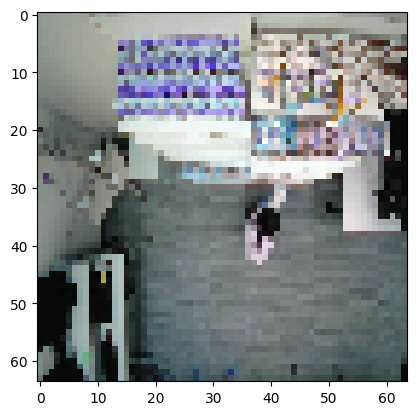

In [ ]:
plt.imshow(features[41])

In [ ]:
index = random.choice(range(len(features)))
index

942

In [ ]:
labels

array([3, 3, 3, ..., 0, 0, 0])

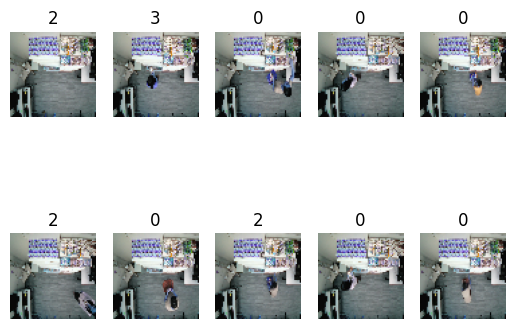

In [ ]:
# features[0].shape
import random
import matplotlib.pyplot as plt
for i in range(10):
    plt.subplot(2,5, i+1)
    # img = random.choice(features)
    index = random.choice(range(len(features)))
    plt.imshow(features[index])
    plt.title(labels[index])
    plt.axis('off')

In [ ]:
features_train, features_test, labels_train, labels_test = train_test_split(features, one_hot_encoded_labels, test_size = 0.2, shuffle = True, random_state = seed_constant)

In [ ]:
# import tensorflow as tf
# from tensorflow.keras.models import Sequential
# from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, LSTM, Dense, Reshape

# # CNN Model
# cnn_model = Sequential()
# cnn_model.add(Conv2D(32, (3, 3), activation='relu', input_shape=(64, 64, 3)))
# cnn_model.add(MaxPooling2D((2, 2)))
# cnn_model.add(Conv2D(64, (3, 3), activation='relu'))
# cnn_model.add(MaxPooling2D((2, 2)))
# cnn_model.add(Flatten())

# # Reshape layer
# reshape_layer = Reshape((5, 5, 256))

# # LSTM Model
# lstm_model = Sequential()
# lstm_model.add(reshape_layer)
# lstm_model.add(LSTM(64, return_sequences=True))
# lstm_model.add(LSTM(64))

# # Combined Model
# combined_model = Sequential()
# combined_model.add(cnn_model)
# combined_model.add(lstm_model)
# combined_model.add(Dense(10, activation='softmax'))

# # Compile the model
# combined_model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# # Print the model summary
# combined_model.summary()


# Creating classifier model

In [ ]:
# Let's create a function that will construct our model
def create_model():

    # We will use a Sequential model for model construction
    model = Sequential()

    # Defining The Model Architecture
    model.add(Conv2D(filters = 64, kernel_size = (3, 3), activation = 'relu', input_shape = (image_height, image_width, 3)))
    model.add(Conv2D(filters = 64, kernel_size = (3, 3), activation = 'relu'))

    model.add(BatchNormalization())
    model.add(MaxPooling2D(pool_size = (2, 2)))
    model.add(Conv2D(filters = 64, kernel_size = (3, 3), activation = 'relu'))
    model.add(Conv2D(filters = 64, kernel_size = (3, 3), activation = 'relu'))
    model.add(GlobalAveragePooling2D())
    model.add(Dense(256, activation = 'relu'))
    model.add(BatchNormalization())
    model.add(Dense(model_output_size, activation = 'softmax'))

    # Printing the models summary
    model.summary()

    return model


# Calling the create_model method
model_v0 = create_model()

print("Model Created Successfully!")

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_14 (Conv2D)          (None, 62, 62, 64)        1792      
                                                                 
 conv2d_15 (Conv2D)          (None, 60, 60, 64)        36928     
                                                                 
 batch_normalization_8 (Batc  (None, 60, 60, 64)       256       
 hNormalization)                                                 
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 30, 30, 64)       0         
 2D)                                                             
                                                                 
 conv2d_16 (Conv2D)          (None, 28, 28, 64)        36928     
                                                                 
 conv2d_17 (Conv2D)          (None, 26, 26, 64)       

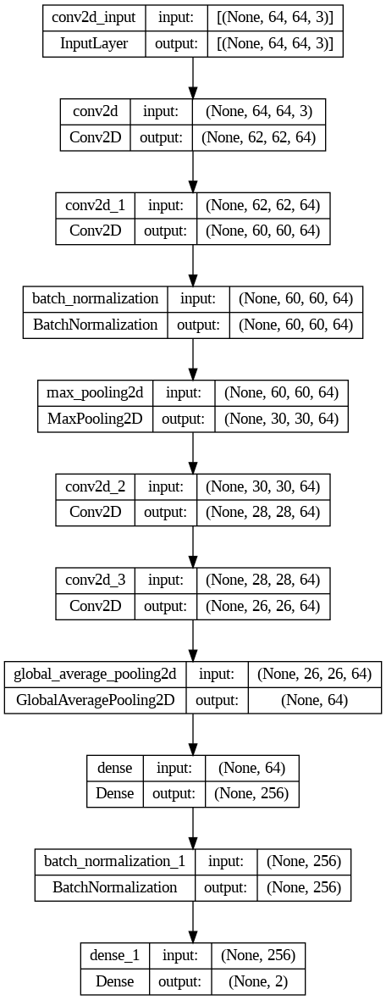

In [ ]:
plot_model(model_v0, to_file = 'model_structure_plot.png', show_shapes = True, show_layer_names = True)


# AlexNet model for classification

In [ ]:
import tensorflow as tf

def alexnet(input_shape, num_classes):
    model = tf.keras.Sequential()
    
    # Layer 1: Convolutional Layer
    model.add(tf.keras.layers.Conv2D(96, kernel_size=(11, 11), strides=(4, 4),
                                     activation='relu', input_shape=input_shape))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.MaxPooling2D(pool_size=(3, 3), strides=(2, 2)))
    
    # Layer 2: Convolutional Layer
    model.add(tf.keras.layers.Conv2D(256, kernel_size=(5, 5), padding='same',
                                     activation='relu'))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.MaxPooling2D(pool_size=(3, 3), strides=(2, 2)))
    
    # Layer 3: Convolutional Layer
    model.add(tf.keras.layers.Conv2D(384, kernel_size=(3, 3), padding='same',
                                     activation='relu'))
    
    # Layer 4: Convolutional Layer
    model.add(tf.keras.layers.Conv2D(384, kernel_size=(3, 3), padding='same',
                                     activation='relu'))
    
    # Layer 5: Convolutional Layer
    model.add(tf.keras.layers.Conv2D(256, kernel_size=(3, 3), padding='same',
                                     activation='relu'))
    model.add(tf.keras.layers.BatchNormalization())
    # model.add(tf.keras.layers.MaxPooling2D(pool_size=(3, 3), strides=(2, 2)))
    
    # Layer 6: Flatten
    model.add(tf.keras.layers.Flatten())
    
    # Layer 7: Fully-Connected Layer
    model.add(tf.keras.layers.Dense(4096, activation='relu'))
    model.add(tf.keras.layers.Dropout(0.5))
    
    # Layer 8: Fully-Connected Layer
    model.add(tf.keras.layers.Dense(4096, activation='relu'))
    model.add(tf.keras.layers.Dropout(0.5))
    
    # Layer 9: Output Layer
    model.add(tf.keras.layers.Dense(num_classes, activation='softmax'))
    
    return model

# Example usage:
input_shape = (64, 64, 3)
num_classes = 4

model_v1 = alexnet(input_shape, num_classes)
model_v1.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_23 (Conv2D)          (None, 14, 14, 96)        34944     
                                                                 
 batch_normalization_13 (Bat  (None, 14, 14, 96)       384       
 chNormalization)                                                
                                                                 
 max_pooling2d_8 (MaxPooling  (None, 6, 6, 96)         0         
 2D)                                                             
                                                                 
 conv2d_24 (Conv2D)          (None, 6, 6, 256)         614656    
                                                                 
 batch_normalization_14 (Bat  (None, 6, 6, 256)        1024      
 chNormalization)                                                
                                                      

# Training with model 1


In [ ]:
# Adding the Early Stopping Callback to the model which will continuously monitor the validation loss metric for every epoch.
# If the models validation loss does not decrease after 15 consecutive epochs, the training will be stopped and the weight which reported the lowest validation loss will be retored in the model.
early_stopping_callback = EarlyStopping(monitor = 'val_loss', patience = 15, mode = 'min', restore_best_weights = True)

# Adding loss, optimizer and metrics values to the model.
model_v0.compile(loss = 'categorical_crossentropy', optimizer = 'Adam', metrics = ["accuracy"])

# Start Training
model_training_history = model_v0.fit(x = features_train, y = labels_train, epochs = 50, batch_size = 4 , shuffle = True, validation_split = 0.2, callbacks = [early_stopping_callback])

Epoch 1/50
1733/1733 [==============================] - 18s 8ms/step - loss: 0.8324 - accuracy: 0.6782 - val_loss: 27.5309 - val_accuracy: 0.2677
Epoch 2/50
1733/1733 [==============================] - 14s 8ms/step - loss: 0.5737 - accuracy: 0.7845 - val_loss: 8.0597 - val_accuracy: 0.2799
Epoch 3/50
1733/1733 [==============================] - 13s 8ms/step - loss: 0.4611 - accuracy: 0.8322 - val_loss: 2.5829 - val_accuracy: 0.4033
Epoch 4/50
1733/1733 [==============================] - 14s 8ms/step - loss: 0.3815 - accuracy: 0.8586 - val_loss: 2.6028 - val_accuracy: 0.4939
Epoch 5/50
1733/1733 [==============================] - 14s 8ms/step - loss: 0.3374 - accuracy: 0.8810 - val_loss: 2.5609 - val_accuracy: 0.6145
Epoch 6/50
1733/1733 [==============================] - 14s 8ms/step - loss: 0.3098 - accuracy: 0.8889 - val_loss: 0.8951 - val_accuracy: 0.8500
Epoch 7/50
1733/1733 [==============================] - 14s 8ms/step - loss: 0.2820 - accuracy: 0.8996 - val_loss: 0.9529 - val_a

In [ ]:
model_evaluation_history = model_v0.evaluate(features_test, labels_test)

68/68 [==============================] - 1s 11ms/step - loss: 0.1473 - accuracy: 0.9382


# Training with AlexNet model

In [122]:
# Adding the Early Stopping Callback to the model which will continuously monitor the validation loss metric for every epoch.
# If the models validation loss does not decrease after 15 consecutive epochs, the training will be stopped and the weight which reported the lowest validation loss will be retored in the model.
early_stopping_callback = EarlyStopping(monitor = 'val_loss', patience = 15, mode = 'min', restore_best_weights = True)

# Adding loss, optimizer and metrics values to the model.
model_v1.compile(loss = 'categorical_crossentropy', optimizer = 'Adam', metrics = ["accuracy"])

# Start Training
model_training_history = model_v1.fit(x = features_train, y = labels_train, epochs = 50, batch_size = 4 , shuffle = True, validation_split = 0.2, callbacks = [early_stopping_callback])

Epoch 1/50
1733/1733 [==============================] - ETA: 0s - loss: 1.4927 - accuracy: 0.4667

1733/1733 [==============================] - 25s 12ms/step - loss: 1.4927 - accuracy: 0.4667 - val_loss: 1.1368 - val_accuracy: 0.5430
Epoch 2/50
1733/1733 [==============================] - 21s 12ms/step - loss: 1.1216 - accuracy: 0.5449 - val_loss: 1.1989 - val_accuracy: 0.4836
Epoch 3/50
1733/1733 [==============================] - 20s 12ms/step - loss: 0.8948 - accuracy: 0.6503 - val_loss: 1.5749 - val_accuracy: 0.3549
Epoch 4/50
1733/1733 [==============================] - 20s 12ms/step - loss: 0.7525 - accuracy: 0.7412 - val_loss: 1.6586 - val_accuracy: 0.7248
Epoch 5/50
1733/1733 [==============================] - 20s 11ms/step - loss: 0.6559 - accuracy: 0.7745 - val_loss: 1.7290 - val_accuracy: 0.4743
Epoch 6/50
1733/1733 [==============================] - 20s 12ms/step - loss: 0.5508 - accuracy: 0.8048 - val_loss: 0.8863 - val_accuracy: 0.7028
Epoch 7/50
1733/1733 [==============================] - 20s 12ms/step - loss: 0.5374 - accuracy: 0.8125 - val_loss: 0.5013 - val_accura

In [123]:
model_v1.summary() 

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_23 (Conv2D)          (None, 14, 14, 96)        34944     
                                                                 
 batch_normalization_13 (Bat  (None, 14, 14, 96)       384       
 chNormalization)                                                
                                                                 
 max_pooling2d_8 (MaxPooling  (None, 6, 6, 96)         0         
 2D)                                                             
                                                                 
 conv2d_24 (Conv2D)          (None, 6, 6, 256)         614656    
                                                                 
 batch_normalization_14 (Bat  (None, 6, 6, 256)        1024      
 chNormalization)                                                
                                                      

In [124]:
model_evaluation_history = model_v1.evaluate(features_test, labels_test)


68/68 [==============================] - 1s 15ms/step - loss: 0.1860 - accuracy: 0.9345


# Plotting charts to see how model perform the process 

In [125]:
def plot_metric(model_training_history, metric_name_1, metric_name_2, plot_name):
  # Get Metric values using metric names as identifiers
  metric_value_1 = model_training_history.history[metric_name_1]
  metric_value_2 = model_training_history.history[metric_name_2]
 
  # Constructing a range object which will be used as time 
  epochs = range(len(metric_value_1))
   
  # Plotting the Graph
  plt.plot(epochs, metric_value_1, 'blue', label = metric_name_1)
  plt.plot(epochs, metric_value_2, 'red', label = metric_name_2)
   
  # Adding title to the plot
  plt.title(str(plot_name))
 
  # Adding legend to the plot
  plt.legend()

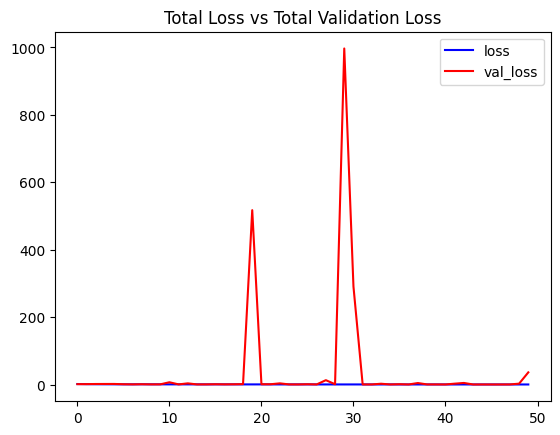

In [126]:
plot_metric(model_training_history, 'loss', 'val_loss', 'Total Loss vs Total Validation Loss')

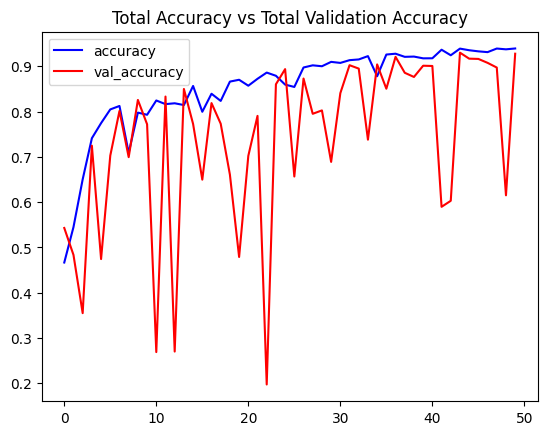

In [127]:
plot_metric(model_training_history, 'accuracy', 'val_accuracy', 'Total Accuracy vs Total Validation Accuracy')


# Predicting live video on the model

In [128]:
def predict_on_live_video(video_file_path, output_file_path, window_size,model):
 
    # Initialize a Deque Object with a fixed size which will be used to implement moving/rolling average functionality.
    predicted_labels_probabilities_deque = deque(maxlen = window_size)
 
    # Reading the Video File using the VideoCapture Object
    video_reader = cv2.VideoCapture(video_file_path)
 
    # Getting the width and height of the video 
    original_video_width = int(video_reader.get(cv2.CAP_PROP_FRAME_WIDTH))
    original_video_height = int(video_reader.get(cv2.CAP_PROP_FRAME_HEIGHT))
 
    # Writing the Overlayed Video Files Using the VideoWriter Object
    video_writer = cv2.VideoWriter(output_file_path, cv2.VideoWriter_fourcc('M', 'P', '4', 'V'), 24, (original_video_width, original_video_height))
 
    while True: 
 
        # Reading The Frame
        status, frame = video_reader.read() 
 
        if not status:
            break
 
        # Resize the Frame to fixed Dimensions
        resized_frame = cv2.resize(frame, (image_height, image_width))
         
        # Normalize the resized frame by dividing it with 255 so that each pixel value then lies between 0 and 1
        normalized_frame = resized_frame / 255
 
        # Passing the Image Normalized Frame to the model and receiving Predicted Probabilities.
        predicted_labels_probabilities = model.predict(np.expand_dims(normalized_frame, axis = 0))[0]
 
        # Appending predicted label probabilities to the deque object
        predicted_labels_probabilities_deque.append(predicted_labels_probabilities)
 
        # Assuring that the Deque is completely filled before starting the averaging process
        if len(predicted_labels_probabilities_deque) == window_size:
 
            # Converting Predicted Labels Probabilities Deque into Numpy array
            predicted_labels_probabilities_np = np.array(predicted_labels_probabilities_deque)
 
            # Calculating Average of Predicted Labels Probabilities Column Wise 
            predicted_labels_probabilities_averaged = predicted_labels_probabilities_np.mean(axis = 0)
 
            # Converting the predicted probabilities into labels by returning the index of the maximum value.
            predicted_label = np.argmax(predicted_labels_probabilities_averaged)
 
            # Accessing The Class Name using predicted label.
            predicted_class_name = classes_list[model.predict(np.expand_dims(normalized_frame, axis = 0)).mean(axis=0).argmax()]

            # Overlaying Class Name Text Ontop of the Frame
            cv2.putText(frame, predicted_class_name, (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 255), 2)
 
        # Writing The Frame
        video_writer.write(frame)
 
 
        # cv2.imshow('Predicted Frames', frame)
 
        # key_pressed = cv2.waitKey(10)
 
        # if key_pressed == ord('q'):
        #     break
 
    # cv2.destroyAllWindows()
 
     
    # Closing the VideoCapture and VideoWriter objects and releasing all resources held by them. 
    video_reader.release()
    video_writer.release()


In [ ]:
# img = cv2.imread("/content/data/Retract_from_Shelf/clip_1_16/rgb/000004.png")
# resized_frame = cv2.resize(img, (image_height, image_width))
# normalized_frame = resized_frame/255.

In [ ]:
# ind = model_v0.predict(np.expand_dims(normalized_frame, axis = 0)).mean(axis=0).argmax()
# classes_list[ind]

In [ ]:
# ind = model_v1.predict(np.expand_dims(normalized_frame, axis = 0)).mean(axis=0).argmax()
# classes_list[ind]

In [129]:
output_directory = 'Videos'
os.makedirs(output_directory, exist_ok = True)
 
# Downloading a YouTube Video
# video_title = download_youtube_videos('https://www.youtube.com/watch?v=8u0qjmHIOcE', output_directory)
 
# Getting the YouTube Video's path you just downloaded

In [130]:
path = "/content/video_2023-06-09_14-41-35.mp4"
# Setting sthe Window Size which will be used by the Rolling Average Proces
window_size = 1
input_video_file_path = f'{output_directory}/{path}.mp4'

# Constructing The Output YouTube Video Path
output_video_file_path = f'{output_directory}/vid2 -Output-WSize {window_size}.mp4'
 
# Calling the predict_on_live_video method to start the Prediction.
predict_on_live_video(path, output_video_file_path, window_size, model_v0)
 
# Play Video File in the Notebook

1/1 [==============================] - 0s 42ms/step


In [132]:
path = "video_2023-06-09_14-41-35.mp4"
# Setting sthe Window Size which will be used by the Rolling Average Proces
window_size = 1
input_video_file_path = f'{output_directory}/{path}.mp4'

# Constructing The Output YouTube Video Path
output_video_file_path2 = f'{output_directory}{path} -Output-WSize {window_size}.mp4'

# Calling the predict_on_live_video method to start the Prediction.
predict_on_live_video(path, output_video_file_path, window_size, model_v1)

1/1 [==============================] - 0s 25ms/step


In [ ]:
VideoFileClip(output_video_file_path).ipython_display(width = 700)


Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



t:   7%|▋         | 96/1315 [00:00<00:10, 112.73it/s, now=None]

KeyboardInterrupt: ignored

In [ ]:
VideoFileClip(output_video_file_path2).ipython_display(width = 700)


Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



t:  91%|█████████ | 134/148 [00:00<00:00, 140.31it/s, now=None]WARNING:py.warnings:/usr/local/lib/python3.10/dist-packages/moviepy/video/io/ffmpeg_reader.py:123: UserWarning: Warning: in file Videos/cropped_vid_2_v2.mp4 -Output-WSize 1.mp4, 1876800 bytes wanted but 0 bytes read,at frame 147/148, at time 6.12/6.13 sec. Using the last valid frame instead.
  warnings.warn("Warning: in file %s, "%(self.filename)+

                                                               

Moviepy - Done !
Moviepy - video ready __temp__.mp4


# Creating TinyVGG model with PyTorch

In [ ]:
from torch import nn
# from torch
class TinyVGGModelV1(nn.Module):
    def __init__(self,
                 input_features:int,
                 hidden_units: int, 
                 output_features:int)->None:
        super().__init__()

        self.conv_block1 = nn.Sequential(
            nn.Conv2d(in_channels=input_features,
                      out_channels=hidden_units,
                      kernel_size=2,
                      stride=1,
                      padding=0),
            nn.BatchNorm2d(hidden_units),
            nn.Tanh(),
            nn.Dropout2d(),
            nn.Conv2d(in_channels=hidden_units,
                      out_channels=hidden_units,
                      kernel_size=2,
                      stride=1,
                      padding=0),
            nn.BatchNorm2d(hidden_units),
            nn.Tanh(),
            nn.Dropout2d(),
            nn.Conv2d(in_channels=hidden_units,
                      out_channels=hidden_units,
                      kernel_size=2,
                      stride=1,
                      padding=0),
            nn.Tanh(),
            nn.Dropout2d(),
            nn.BatchNorm2d(hidden_units),
            nn.MaxPool2d(kernel_size=2, 
                         stride=2,
                         padding=0)
        )

        self.conv_block2 = nn.Sequential(
            nn.Conv2d(in_channels=hidden_units,
                      out_channels=hidden_units,
                      kernel_size=2,
                      stride=1,
                      padding=0),
            nn.BatchNorm2d(hidden_units),
            nn.Tanh(),
            nn.Dropout2d(),
            nn.Conv2d(in_channels=hidden_units,
                      out_channels=hidden_units,
                      kernel_size=2,
                      stride=1,
                      padding=0),
            nn.BatchNorm2d(hidden_units),
            nn.Tanh(),
            nn.Dropout2d(),
            nn.Conv2d(in_channels=hidden_units,
                      out_channels=hidden_units,
                      kernel_size=2,
                      stride=1,
                      padding=0),
            nn.Tanh(),
            nn.BatchNorm2d(hidden_units),
            nn.Dropout2d(),
            nn.MaxPool2d(kernel_size=2,
                         stride=2,
                         padding=0)
        )

        self.conv_block3 = nn.Sequential(
            nn.Conv2d(in_channels=hidden_units,
                      out_channels=hidden_units,
                      kernel_size=2,
                      stride=1,
                      padding=0),
            nn.BatchNorm2d(hidden_units),
            nn.Tanh(),
            nn.Dropout2d(),
            nn.Conv2d(in_channels=hidden_units,
                      out_channels=hidden_units,
                      kernel_size=2,
                      stride=1,
                      padding=0),
            nn.BatchNorm2d(hidden_units),
            nn.Tanh(),
            nn.Dropout2d(),
            nn.Conv2d(in_channels=hidden_units,
                      out_channels=hidden_units,
                      kernel_size=2,
                      stride=1,
                      padding=0),
            nn.Tanh(),
            nn.BatchNorm2d(hidden_units),
            nn.Dropout2d(),
            nn.MaxPool2d(kernel_size=2,
                         stride=2,
                         padding=0)
        )

        self.classifier = nn.Sequential(
            nn.Flatten(),
            nn.Linear(in_features=hidden_units*5*5,
                      out_features=output_features)
        )
    
    def forward(self, x):
        # return self.classifier(self.conv_block2(self.conv_block1(x)))
        x = self.conv_block1(x)
        # print(x.shape)
        x = self.conv_block2(x)
        x = self.conv_block3(x)
        # print(x.shape)
        x = self.classifier(x)
        # print(x.shape)
        return x

In [ ]:
import torch
device = "cuda" if torch.cuda.is_available() else "cpu"
torch.manual_seed(42)
model_v2 = TinyVGGModelV1(input_features=3,
                          hidden_units=64,
                          output_features=5).to(device)
model_v2

TinyVGGModelV1(
  (conv_block1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(2, 2), stride=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): Tanh()
    (3): Dropout2d(p=0.5, inplace=False)
    (4): Conv2d(64, 64, kernel_size=(2, 2), stride=(1, 1))
    (5): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): Tanh()
    (7): Dropout2d(p=0.5, inplace=False)
    (8): Conv2d(64, 64, kernel_size=(2, 2), stride=(1, 1))
    (9): Tanh()
    (10): Dropout2d(p=0.5, inplace=False)
    (11): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (12): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (conv_block2): Sequential(
    (0): Conv2d(64, 64, kernel_size=(2, 2), stride=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): Tanh()
    (3): Dropout2d(p=0.5, inplace=False)
    (4): Conv2d(

# Preparing data for pytorch model

In [ ]:
features_train, features_test, labels_train, labels_test = train_test_split(features, one_hot_encoded_labels, test_size = 0.2, shuffle = True, random_state = seed_constant)


2

In [ ]:
# plt.imshow(features_train[0].reshape(3,64,64).shape)

In [ ]:
labeld = []
train_data_custom = []
test_data_custom = []
for i in range(labels_train.shape[0]):
    train_data_custom.append([features_train[i].reshape(3,64,64).astype(np.float32), np.where(labels_train[i]==1)[0][0]])
for i in range(labels_test.shape[0]):
    test_data_custom.append([features_test[i].reshape(3,64,64).astype(np.float32), np.where(labels_test[i]==1)[0][0]])

In [ ]:
# labeld

In [ ]:
from torch.utils.data import DataLoader
BATCH_SIZE=32
NUM_WORKERS = os.cpu_count()

train_dataloader_custom = DataLoader(dataset=train_data_custom,
                                     batch_size=BATCH_SIZE,
                                     num_workers = NUM_WORKERS,
                                     shuffle=True)

test_dataloader_custom = DataLoader(dataset=test_data_custom, 
                                    batch_size=BATCH_SIZE,
                                    num_workers = NUM_WORKERS,
                                    shuffle=False)

In [ ]:

img_batch, label_batch = next(iter(train_dataloader_custom))
img_batch.shape, label_batch.shape

(torch.Size([32, 3, 64, 64]), torch.Size([32]))

In [ ]:
# !pip install torchinfo

In [ ]:


from torchinfo import summary

summary(model= model_v2, input_size=(img_batch.shape))

Layer (type:depth-idx)                   Output Shape              Param #
TinyVGGModelV1                           [32, 5]                   --
├─Sequential: 1-1                        [32, 64, 30, 30]          --
│    └─Conv2d: 2-1                       [32, 64, 63, 63]          832
│    └─BatchNorm2d: 2-2                  [32, 64, 63, 63]          128
│    └─Tanh: 2-3                         [32, 64, 63, 63]          --
│    └─Dropout2d: 2-4                    [32, 64, 63, 63]          --
│    └─Conv2d: 2-5                       [32, 64, 62, 62]          16,448
│    └─BatchNorm2d: 2-6                  [32, 64, 62, 62]          128
│    └─Tanh: 2-7                         [32, 64, 62, 62]          --
│    └─Dropout2d: 2-8                    [32, 64, 62, 62]          --
│    └─Conv2d: 2-9                       [32, 64, 61, 61]          16,448
│    └─Tanh: 2-10                        [32, 64, 61, 61]          --
│    └─Dropout2d: 2-11                   [32, 64, 61, 61]          --
│   

# Training step for TinyVGG model

In [ ]:

#Creating train_step function
def train_step(model: nn.Module,
               optimizer: torch.optim.Optimizer,
               loss_fn: nn.Module,
               train_dataloader: torch.utils.data.DataLoader,
               device=device):
    train_loss, train_acc = 0,0

    #Put the model train mode
    model.train()

    #Gettin' learning rate 
    lr = [param['lr'] for param in optimizer.param_groups]
  
    #Loopin' through
    for batch, (X,y) in enumerate(train_dataloader):
    
        #Put the data to the target device
        X, y = X.to(device), y.to(device)
    
        #Forward-prop
        y_probs = model(X)
    
        #Calculate the loss and acc
        loss = loss_fn(y_probs, y)
        train_loss+=loss.item()
        y_pred_class = torch.argmax(torch.softmax(y_probs, dim=1),dim=1)
        train_acc+= (y_pred_class==y).sum().item()/len(y_probs)
                
        #Optimizer zero grad
        optimizer.zero_grad()
    
        #Backpropagation
        loss.backward()
    
        #Optimizer step
        optimizer.step()

    #Calculate the accumulated loss and acc by dividing length of data
    train_loss/=len(train_dataloader)
    train_acc/=len(train_dataloader)

    #Printing the summary
    print(f"Train_loss: {train_loss:.4f}, Train_accuracy: {train_acc:.2f}%")

    #returning calculated loss and acc
    return train_loss, train_acc

#Creating test_step function
def test_step(model: nn.Module, 
              loss_fn: nn.Module,
              test_dataloader: torch.utils.data.DataLoader,
              device=device):
    #Put the model to the eval mode
    model.eval()

    test_loss, test_acc = 0,0

    with torch.inference_mode():
        for batch, (X, y) in enumerate(test_dataloader):

            #Put the data to the target device
            X, y = X.to(device), y.to(device)

            #Forward-prop
            y_probs = model(X)

            #Calculate the loss and acc
            loss = loss_fn(y_probs, y)
            test_loss+=loss.item()
            y_pred_class = torch.argmax(torch.softmax(y_probs, dim=1), dim=1)
            test_acc+= (y_pred_class==y).sum().item()/len(y_probs)

        #Calculating original loss and acc by dividing the length of data per batch
        test_loss/=len(test_dataloader)
        test_acc /=len(test_dataloader)

        #Printing the summary
        print(f"Test_loss: {test_loss:.4f}, Test_accuracy: {test_acc:.2f}%")

        #Returning neccesary things
        return test_loss, test_acc

In [ ]:
def timer_fn(
    start: float,
    end: float,
    device=device):
    total_time = end-start
    print(f"Total time of the process is {total_time:.3f} on the {device}")
    return total_time

# Fine-tuning on TinyVGG model

In [ ]:

torch.manual_seed(42)
import numpy as np 
def Fine_tune(model:nn.Module,
              train_dataloader: torch.utils.data,
              test_dataloader:torch.utils.data,
              optimizer,
              loss_fn:nn.Module,
              epochs=5):
    from timeit import default_timer as timer
    from tqdm.auto import tqdm
    start_time_on_gpu = timer()
    train_losses, test_losses = [], []
    train_accs, test_accs = [], []
    results = []
    for epoch in tqdm(range(epochs)):
        print(f"Epoch: {epoch}\n-----------------")

        train_loss, train_acc = train_step(model=model,
                   optimizer=optimizer,
                   loss_fn=loss_fn,
                   train_dataloader=train_dataloader)
        train_losses.append(train_loss)
        train_accs.append(train_acc)

        test_loss, test_acc = test_step(model=model,
                                        loss_fn=loss_fn,
                                        test_dataloader=test_dataloader)
        test_losses.append(test_loss)
        test_accs.append(test_acc)

        results.append([train_loss, train_acc, test_loss, test_acc])
    end_time_on_gpu = timer()
    total_train_time_on_model_1 = timer_fn(start_time_on_gpu, end_time_on_gpu)

    fig = plt.figure(figsize=(15,7))
    rows, cols = 1,2
    # for i in range(1, rows*cols+1):
    fig.add_subplot(rows, cols,1)
    plt.plot(np.arange(1,epochs+1), np.array(train_losses), label='train_loss')
    plt.plot(np.arange(1,epochs+1),np.array(test_losses), label='test_loss')
    plt.title("Train_loss and Test_loss by epoch")
    plt.xlabel("Epochs")
    plt.legend()
    fig.add_subplot(rows, cols,2)
    plt.plot(np.arange(1,epochs+1),np.array(train_accs), label='train_acc')
    plt.plot(np.arange(1,epochs+1), np.array(test_accs), label='test_acc')
    plt.title("Train_acc and Test_acc by epoch")
    plt.xlabel("Epochs")
    plt.legend();
    return results

In [ ]:
loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(params=model_v2.parameters(), lr=0.001, weight_decay=0.005)

  0%|          | 0/20 [00:00<?, ?it/s]

Epoch: 0
-----------------
Train_loss: 0.8764, Train_accuracy: 0.65%
Test_loss: 0.7833, Test_accuracy: 0.68%
Epoch: 1
-----------------
Train_loss: 0.8745, Train_accuracy: 0.66%
Test_loss: 0.7917, Test_accuracy: 0.68%
Epoch: 2
-----------------
Train_loss: 0.8758, Train_accuracy: 0.65%
Test_loss: 0.7650, Test_accuracy: 0.70%
Epoch: 3
-----------------
Train_loss: 0.8719, Train_accuracy: 0.66%
Test_loss: 0.7804, Test_accuracy: 0.69%
Epoch: 4
-----------------
Train_loss: 0.8606, Train_accuracy: 0.66%
Test_loss: 0.7465, Test_accuracy: 0.71%
Epoch: 5
-----------------
Train_loss: 0.8523, Train_accuracy: 0.66%
Test_loss: 0.7307, Test_accuracy: 0.73%
Epoch: 6
-----------------
Train_loss: 0.8396, Train_accuracy: 0.67%
Test_loss: 0.7462, Test_accuracy: 0.70%
Epoch: 7
-----------------
Train_loss: 0.8557, Train_accuracy: 0.66%
Test_loss: 0.7486, Test_accuracy: 0.71%
Epoch: 8
-----------------
Train_loss: 0.8366, Train_accuracy: 0.67%
Test_loss: 0.8414, Test_accuracy: 0.66%
Epoch: 9
----------

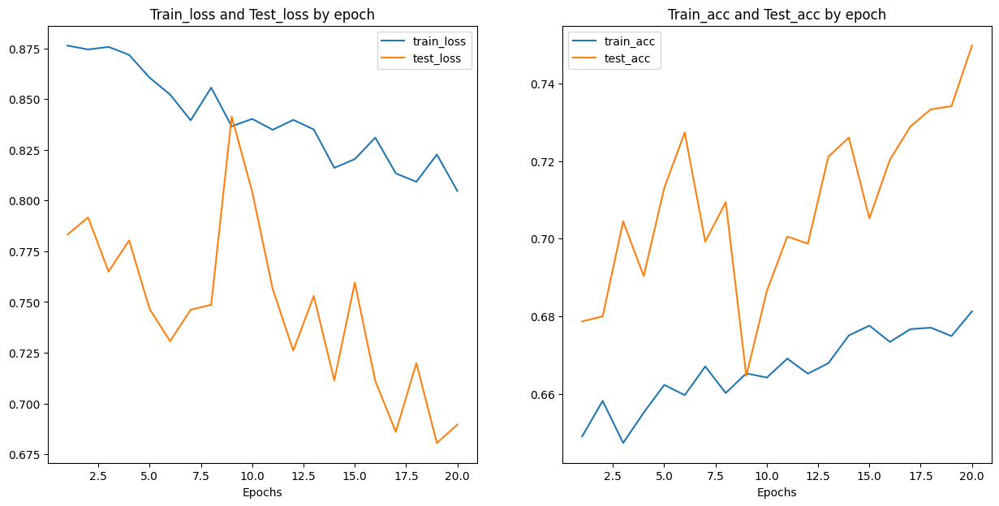

In [ ]:
model_v2_results = Fine_tune(model=model_v2,
          train_dataloader=train_dataloader_custom,
          test_dataloader=test_dataloader_custom,
          optimizer=optimizer,
          loss_fn=loss_fn,
          epochs=20)

In [ ]:
r_img = cv2.imread("/content/data/Inspect_Shelf/clip_2_4/rgb/000002.png")
r_img = cv2.resize(r_img, (64,64), cv2.INTER_CUBIC)/255

In [ ]:
model_v2(torch.from_numpy(r_img.reshape(3, 64, 64)).type(torch.float32).to(device).unsqueeze(0)).argmax()

tensor(2, device='cuda:0')

# Predicting live video on TinyVGG model

In [ ]:
def predict_on_live_video(video_file_path, output_file_path, window_size):
 
    # Initialize a Deque Object with a fixed size which will be used to implement moving/rolling average functionality.
    predicted_labels_probabilities_deque = deque(maxlen = window_size)
 
    # Reading the Video File using the VideoCapture Object
    video_reader = cv2.VideoCapture(video_file_path)
 
    # Getting the width and height of the video 
    original_video_width = int(video_reader.get(cv2.CAP_PROP_FRAME_WIDTH))
    original_video_height = int(video_reader.get(cv2.CAP_PROP_FRAME_HEIGHT))
 
    # Writing the Overlayed Video Files Using the VideoWriter Object
    video_writer = cv2.VideoWriter(output_file_path, cv2.VideoWriter_fourcc('M', 'P', '4', 'V'), 24, (original_video_width, original_video_height))
 
    while True: 
 
        # Reading The Frame
        status, frame = video_reader.read() 
 
        if not status:
            break
 
        # Resize the Frame to fixed Dimensions
        resized_frame = cv2.resize(frame, (image_height, image_width))
         
        # Normalize the resized frame by dividing it with 255 so that each pixel value then lies between 0 and 1
        normalized_frame = resized_frame / 255
 
        # Passing the Image Normalized Frame to the model and receiving Predicted Probabilities.
        predicted_labels_probabilities = model_v2(torch.from_numpy(normalized_frame.reshape(3, 64, 64)).type(torch.float32).to(device).unsqueeze(0))

        # Appending predicted label probabilities to the deque object
        predicted_labels_probabilities_deque.append(predicted_labels_probabilities.to('cpu').detach().numpy())
 
        # Assuring that the Deque is completely filled before starting the averaging process
        if len(predicted_labels_probabilities_deque) == window_size:
 
            # Converting Predicted Labels Probabilities Deque into Numpy array
            predicted_labels_probabilities_np =np.array(predicted_labels_probabilities_deque)
 
            # Calculating Average of Predicted Labels Probabilities Column Wise 
            predicted_labels_probabilities_averaged = predicted_labels_probabilities_np.mean(axis = 0)
 
            # Converting the predicted probabilities into labels by returning the index of the maximum value.
            predicted_label = np.argmax(predicted_labels_probabilities_averaged)
 
            # Accessing The Class Name using predicted label.
            predicted_class_name = classes_list[predicted_label]
           
            # Overlaying Class Name Text Ontop of the Frame
            cv2.putText(frame, predicted_class_name, (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 255), 2)
 
        # Writing The Frame
        video_writer.write(frame)
 
 
        # cv2.imshow('Predicted Frames', frame)
 
        # key_pressed = cv2.waitKey(10)
 
        # if key_pressed == ord('q'):
        #     break
 
    # cv2.destroyAllWindows()
 
     
    # Closing the VideoCapture and VideoWriter objects and releasing all resources held by them. 
    video_reader.release()
    video_writer.release()


In [ ]:
path = "video_2023-06-09_14-41-35.mp4"
# Setting sthe Window Size which will be used by the Rolling Average Proces
window_size = 1
input_video_file_path = f'{output_directory}/{path}.mp4'

# Constructing The Output YouTube Video Path
output_video_file_path = f'{output_directory}/{path} -Output-WSize {window_size}.mp4'
 
# Calling the predict_on_live_video method to start the Prediction.
predict_on_live_video(path, output_video_file_path, window_size)

In [ ]:
VideoFileClip(output_video_file_path).ipython_display(width = 700)


Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4
